<a href="https://colab.research.google.com/github/benihime91/Covid-Waste-Detection/blob/main/IceVision_model_tuning_2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# Covid 19 Waste Detection

To train we will use the [IceVision](https://github.com/airctic/icevision) Library.

<img src="https://github.com/airctic/icevision/blob/master/images/icevision-logo-slogan.png?raw=true" width="500">


This notebook builds upon this [tutorial](https://github.com/airctic/icevision/blob/master/notebooks/wandb_efficientdet.ipynb).


# Installing IceVision, IceData

In [2]:
!pip install -Uqq git+git://github.com/airctic/icevision.git#egg=icevision[all]
!pip install -Uqq git+git://github.com/airctic/icedata.git
!pip install -Uqq PyYAML==5.4.1

     |████████████████████████████████| 61kB 4.7MB/s 
     |████████████████████████████████| 81kB 6.7MB/s 
     |████████████████████████████████| 81kB 10.9MB/s 
     |████████████████████████████████| 61kB 9.7MB/s 
     |████████████████████████████████| 61kB 8.5MB/s 
     |████████████████████████████████| 3.0MB 48.5MB/s 
     |████████████████████████████████| 204kB 53.6MB/s 
     |████████████████████████████████| 808kB 46.7MB/s 
     |████████████████████████████████| 112kB 8.8MB/s 
     |████████████████████████████████| 1.8MB 51.5MB/s 
     |████████████████████████████████| 51kB 7.1MB/s 
     |████████████████████████████████| 38.2MB 78kB/s 
     |████████████████████████████████| 952kB 37.1MB/s 
     |████████████████████████████████| 276kB 53.3MB/s 
     |████████████████████████████████| 112kB 59.5MB/s 
     |████████████████████████████████| 10.6MB 47.4MB/s 
     |████████████████████████████████| 829kB 31.9MB/s 
     |████████████████████████████████| 348kB 39.1MB/s 
    

> Note: Important `Restart Runtime`

In [3]:
# Needs to restart runtime in Google Colab
# What GPU are we using?
!nvidia-smi

Fri Jun  4 15:37:41 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 465.27       Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   53C    P8    10W /  70W |      0MiB / 15109MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

## Imports

In [1]:
import icedata
from icevision.all import *
import torch
from torch import nn, optim

# Loading the Dataset

In [5]:
!unzip /content/drive/MyDrive/train.zip -d /content/ > /dev/null

In [2]:
data_dir = Path("/content/train/")

In [3]:
parser = parsers.VOCBBoxParser(data_dir, data_dir)

Let's check out the class map for our Dataset to ensure that all the classes are properly registerd -

In [4]:
data_splitter = RandomSplitter([.8, .2])
train_records, valid_records = parser.parse(data_splitter)

  0%|          | 0/376 [00:00<?, ?it/s]

INFO     - Autofixing records | icevision.parsers.parser:parse:136


  0%|          | 0/300 [00:00<?, ?it/s]

AUTOFIX-SUCCESS - (record_id: 122) - Clipping bbox xmax from 1025 to image width 1024 (Before: <BBox (xmin:701, ymin:397, xmax:1025, ymax:528)>) | icevision.utils.logger_utils:autofix_log:17
AUTOFIX-SUCCESS - (record_id: 122) - Clipping bbox xmax from 1025 to image width 1024 (Before: <BBox (xmin:835, ymin:543, xmax:1025, ymax:895)>) | icevision.utils.logger_utils:autofix_log:17
AUTOFIX-SUCCESS - (record_id: 160) - Clipping bbox ymax from 1025 to image height 1024 (Before: <BBox (xmin:353, ymin:881, xmax:641, ymax:1025)>) | icevision.utils.logger_utils:autofix_log:17
AUTOFIX-SUCCESS - (record_id: 106) - Clipping bbox xmax from 1025 to image width 1024 (Before: <BBox (xmin:683, ymin:716, xmax:1025, ymax:950)>) | icevision.utils.logger_utils:autofix_log:17


  0%|          | 0/76 [00:00<?, ?it/s]

AUTOFIX-SUCCESS - (record_id: 126) - Clipping bbox ymax from 1025 to image height 1024 (Before: <BBox (xmin:552, ymin:607, xmax:1005, ymax:1025)>) | icevision.utils.logger_utils:autofix_log:17


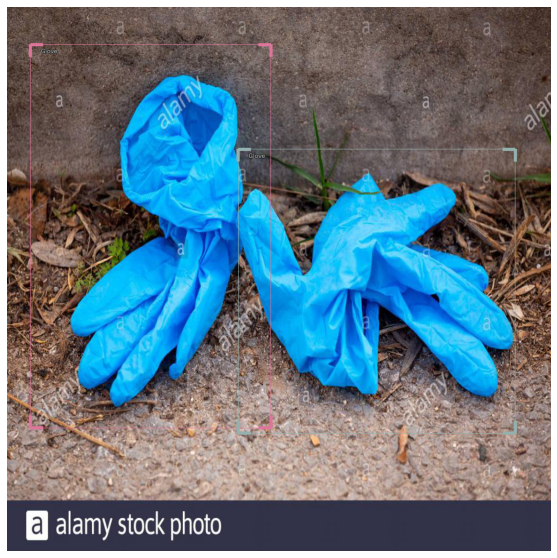

In [11]:
class_map = parser.class_map
show_record(train_records[80], class_map=class_map, figsize=(10,10))

## Train and Validation Datasets

In [12]:
presize = 900
size = 512

train_tfms = tfms.A.Adapter([*tfms.A.aug_tfms(size=size, presize=presize), tfms.A.Normalize()])
valid_tfms = tfms.A.Adapter([*tfms.A.resize_and_pad(size), tfms.A.Normalize()])

train_ds = Dataset(train_records, train_tfms)
valid_ds = Dataset(valid_records, valid_tfms)

len(train_ds), len(valid_ds)

(300, 76)

## Create the model
In IceVision, we need to select the model type and backbone. For this tutorial, we are selecting efficientdet and the `efficientdet-b3` backbone. Some models require additional information, such as the `image_size`.

In [13]:
# Library and model selection
model_type = models.ross.efficientdet
backbone = model_type.backbones.d0(pretrained=True)

# The efficientdet model requires an img_size parameter
extra_args = {'img_size' : size}

model = efficientdet.model(backbone=backbone, num_classes=len(parser.class_map), **extra_args)

## Create the dataloaders

In [14]:
# DataLoaders
train_dl = model_type.train_dl(train_ds, batch_size=8, shuffle=True)
valid_dl = model_type.valid_dl(valid_ds, batch_size=8, shuffle=False)

Showing what's inside a batch

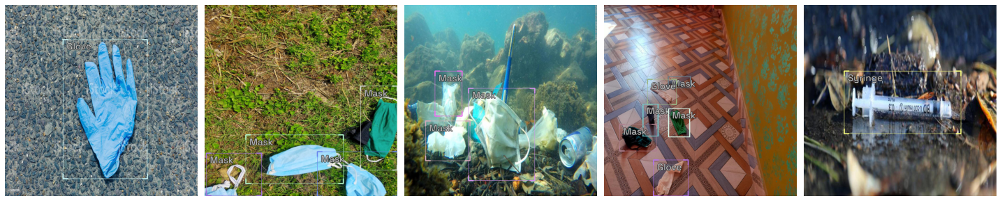

In [18]:
dl = model_type.valid_dl(valid_ds, batch_size=5, shuffle=True)
batch = first(dl)
model_type.show_batch(batch, ncols=5, figsize=(20,15))

# Training

In [19]:
class LitModel(model_type.lightning.ModelAdapter):
    
    def configure_optimizers(self):
        opt = optim.SGD(self.parameters(), lr=0.005, momentum=0.9, weight_decay=0.0005)
        sched = optim.lr_scheduler.StepLR(opt, step_size=10, verbose=True)
        return [opt], [sched]

metrics = [COCOMetric(metric_type=COCOMetricType.bbox)]

In [20]:
learn = LitModel(model, metrics=metrics)

cbs = [
    pl.callbacks.ModelCheckpoint(dirpath="/content/outputs/", verbose=1, save_weights_only=True, monitor="valid/loss"),
]
log = [
    pl.loggers.CSVLogger(save_dir="/content/outputs/", name="efficientdet-d0"),
    pl.loggers.TensorBoardLogger(save_dir="/content/lightning_logs/", name="efficientdet-d0")
]

trainer = pl.Trainer(max_epochs=40, gpus=-1, precision=16, callbacks=cbs, logger=log, log_every_n_steps=1)

GPU available: True, used: True
TPU available: False, using: 0 TPU cores
Using native 16bit precision.


In [21]:
%%time
trainer.fit(learn, train_dl, valid_dl)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Adjusting learning rate of group 0 to 5.0000e-03.



  | Name  | Type          | Params
----------------------------------------
0 | model | DetBenchTrain | 3.8 M 
----------------------------------------
3.8 M     Trainable params
0         Non-trainable params
3.8 M     Total params
15.307    Total estimated model params size (MB)


Validation sanity check: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Epoch 0, global step 37: valid/loss reached 1.48961 (best 1.48961), saving model to "/content/outputs/epoch=0-step=37.ckpt" as top 1


Adjusting learning rate of group 0 to 5.0000e-03.


Validating: 0it [00:00, ?it/s]

Epoch 1, global step 75: valid/loss reached 1.29140 (best 1.29140), saving model to "/content/outputs/epoch=1-step=75.ckpt" as top 1


Adjusting learning rate of group 0 to 5.0000e-03.


Validating: 0it [00:00, ?it/s]

Epoch 2, global step 113: valid/loss reached 1.02397 (best 1.02397), saving model to "/content/outputs/epoch=2-step=113.ckpt" as top 1


Adjusting learning rate of group 0 to 5.0000e-03.


Validating: 0it [00:00, ?it/s]

Epoch 3, global step 151: valid/loss reached 0.88481 (best 0.88481), saving model to "/content/outputs/epoch=3-step=151.ckpt" as top 1


Adjusting learning rate of group 0 to 5.0000e-03.


Validating: 0it [00:00, ?it/s]

Epoch 4, global step 189: valid/loss reached 0.82384 (best 0.82384), saving model to "/content/outputs/epoch=4-step=189.ckpt" as top 1


Adjusting learning rate of group 0 to 5.0000e-03.


Validating: 0it [00:00, ?it/s]

Epoch 5, global step 227: valid/loss reached 0.75184 (best 0.75184), saving model to "/content/outputs/epoch=5-step=227.ckpt" as top 1


Adjusting learning rate of group 0 to 5.0000e-03.


Validating: 0it [00:00, ?it/s]

Epoch 6, global step 265: valid/loss was not in top 1


Adjusting learning rate of group 0 to 5.0000e-03.


Validating: 0it [00:00, ?it/s]

Epoch 7, global step 303: valid/loss reached 0.70159 (best 0.70159), saving model to "/content/outputs/epoch=7-step=303.ckpt" as top 1


Adjusting learning rate of group 0 to 5.0000e-03.


Validating: 0it [00:00, ?it/s]

Epoch 8, global step 341: valid/loss reached 0.69933 (best 0.69933), saving model to "/content/outputs/epoch=8-step=341.ckpt" as top 1


Adjusting learning rate of group 0 to 5.0000e-03.


Validating: 0it [00:00, ?it/s]

Epoch 9, global step 379: valid/loss reached 0.69752 (best 0.69752), saving model to "/content/outputs/epoch=9-step=379.ckpt" as top 1


Adjusting learning rate of group 0 to 5.0000e-04.


Validating: 0it [00:00, ?it/s]

Epoch 10, global step 417: valid/loss reached 0.68538 (best 0.68538), saving model to "/content/outputs/epoch=10-step=417.ckpt" as top 1


Adjusting learning rate of group 0 to 5.0000e-04.


Validating: 0it [00:00, ?it/s]

Epoch 11, global step 455: valid/loss reached 0.67045 (best 0.67045), saving model to "/content/outputs/epoch=11-step=455.ckpt" as top 1


Adjusting learning rate of group 0 to 5.0000e-04.


Validating: 0it [00:00, ?it/s]

Epoch 12, global step 493: valid/loss reached 0.66479 (best 0.66479), saving model to "/content/outputs/epoch=12-step=493.ckpt" as top 1


Adjusting learning rate of group 0 to 5.0000e-04.


Validating: 0it [00:00, ?it/s]

Epoch 13, global step 531: valid/loss was not in top 1


Adjusting learning rate of group 0 to 5.0000e-04.


Validating: 0it [00:00, ?it/s]

Epoch 14, global step 569: valid/loss was not in top 1


Adjusting learning rate of group 0 to 5.0000e-04.


Validating: 0it [00:00, ?it/s]

Epoch 15, global step 607: valid/loss reached 0.66259 (best 0.66259), saving model to "/content/outputs/epoch=15-step=607.ckpt" as top 1


Adjusting learning rate of group 0 to 5.0000e-04.


Validating: 0it [00:00, ?it/s]

Epoch 16, global step 645: valid/loss reached 0.66167 (best 0.66167), saving model to "/content/outputs/epoch=16-step=645.ckpt" as top 1


Adjusting learning rate of group 0 to 5.0000e-04.


Validating: 0it [00:00, ?it/s]

Epoch 17, global step 683: valid/loss reached 0.65981 (best 0.65981), saving model to "/content/outputs/epoch=17-step=683.ckpt" as top 1


Adjusting learning rate of group 0 to 5.0000e-04.


Validating: 0it [00:00, ?it/s]

Epoch 18, global step 721: valid/loss was not in top 1


Adjusting learning rate of group 0 to 5.0000e-04.


Validating: 0it [00:00, ?it/s]

Epoch 19, global step 759: valid/loss reached 0.65280 (best 0.65280), saving model to "/content/outputs/epoch=19-step=759.ckpt" as top 1


Adjusting learning rate of group 0 to 5.0000e-05.


Validating: 0it [00:00, ?it/s]

Epoch 20, global step 797: valid/loss was not in top 1


Adjusting learning rate of group 0 to 5.0000e-05.


Validating: 0it [00:00, ?it/s]

Epoch 21, global step 835: valid/loss was not in top 1


Adjusting learning rate of group 0 to 5.0000e-05.


Validating: 0it [00:00, ?it/s]

Epoch 22, global step 873: valid/loss was not in top 1


Adjusting learning rate of group 0 to 5.0000e-05.


Validating: 0it [00:00, ?it/s]

Epoch 23, global step 911: valid/loss was not in top 1


Adjusting learning rate of group 0 to 5.0000e-05.


Validating: 0it [00:00, ?it/s]

Epoch 24, global step 949: valid/loss was not in top 1


Adjusting learning rate of group 0 to 5.0000e-05.


Validating: 0it [00:00, ?it/s]

Epoch 25, global step 987: valid/loss was not in top 1


Adjusting learning rate of group 0 to 5.0000e-05.


Validating: 0it [00:00, ?it/s]

Epoch 26, global step 1025: valid/loss was not in top 1


Adjusting learning rate of group 0 to 5.0000e-05.


Validating: 0it [00:00, ?it/s]

Epoch 27, global step 1063: valid/loss was not in top 1


Adjusting learning rate of group 0 to 5.0000e-05.


Validating: 0it [00:00, ?it/s]

Epoch 28, global step 1101: valid/loss was not in top 1


Adjusting learning rate of group 0 to 5.0000e-05.


Validating: 0it [00:00, ?it/s]

Epoch 29, global step 1139: valid/loss was not in top 1


Adjusting learning rate of group 0 to 5.0000e-06.


Validating: 0it [00:00, ?it/s]

Epoch 30, global step 1177: valid/loss was not in top 1


Adjusting learning rate of group 0 to 5.0000e-06.


Validating: 0it [00:00, ?it/s]

Epoch 31, global step 1215: valid/loss was not in top 1


Adjusting learning rate of group 0 to 5.0000e-06.


Validating: 0it [00:00, ?it/s]

Epoch 32, global step 1253: valid/loss was not in top 1


Adjusting learning rate of group 0 to 5.0000e-06.


Validating: 0it [00:00, ?it/s]

Epoch 33, global step 1291: valid/loss was not in top 1


Adjusting learning rate of group 0 to 5.0000e-06.


Validating: 0it [00:00, ?it/s]

Epoch 34, global step 1329: valid/loss was not in top 1


Adjusting learning rate of group 0 to 5.0000e-06.


Validating: 0it [00:00, ?it/s]

Epoch 35, global step 1367: valid/loss was not in top 1


Adjusting learning rate of group 0 to 5.0000e-06.


Validating: 0it [00:00, ?it/s]

Epoch 36, global step 1405: valid/loss was not in top 1


Adjusting learning rate of group 0 to 5.0000e-06.


Validating: 0it [00:00, ?it/s]

Epoch 37, global step 1443: valid/loss was not in top 1


Adjusting learning rate of group 0 to 5.0000e-06.


Validating: 0it [00:00, ?it/s]

Epoch 38, global step 1481: valid/loss was not in top 1


Adjusting learning rate of group 0 to 5.0000e-06.


Validating: 0it [00:00, ?it/s]

Epoch 39, global step 1519: valid/loss was not in top 1


Adjusting learning rate of group 0 to 5.0000e-07.
CPU times: user 17min 46s, sys: 36.6 s, total: 18min 22s
Wall time: 16min 8s


In [22]:
results = trainer.validate(verbose=False)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Validating: 0it [00:00, ?it/s]

In [24]:
import pprint
pprint.pprint(results)

[{'COCOMetric/AP (IoU=0.50) area=all': 0.7920334794669986,
  'COCOMetric/AP (IoU=0.50:0.95) area=all': 0.3825436350075078,
  'COCOMetric/AP (IoU=0.50:0.95) area=large': 0.42369768925134377,
  'COCOMetric/AP (IoU=0.50:0.95) area=medium': 0.20671695834194426,
  'COCOMetric/AP (IoU=0.50:0.95) area=small': -1.0,
  'COCOMetric/AP (IoU=0.75) area=all': 0.2736959948856877,
  'COCOMetric/AR (IoU=0.50:0.95) area=all maxDets=1': 0.3777277277277277,
  'COCOMetric/AR (IoU=0.50:0.95) area=all maxDets=10': 0.5226360976360975,
  'COCOMetric/AR (IoU=0.50:0.95) area=all maxDets=100': 0.5343478093478093,
  'COCOMetric/AR (IoU=0.50:0.95) area=large maxDets=100': 0.5614234511008703,
  'COCOMetric/AR (IoU=0.50:0.95) area=medium maxDets=100': 0.3851851851851852,
  'COCOMetric/AR (IoU=0.50:0.95) area=small maxDets=100': -1.0,
  'valid/box_loss': 0.004368244204670191,
  'valid/class_loss': 0.43438777327537537,
  'valid/loss': 0.6528000235557556}]


In [25]:
%reload_ext tensorboard
%tensorboard --logdir "/content/lightning_logs/"

<IPython.core.display.Javascript object>

In [27]:
!tensorboard dev upload --logdir "lightning_logs/efficientdet-d0/" \
    --name "Covid Waste Detection Ice Vision" \
    --description "Efficientdet-0 Model Training ver2.0.0" \
    --one_shot

2021-06-04 16:06:00.847771: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully opened dynamic library libcudart.so.11.0

***** TensorBoard Uploader *****

This will upload your TensorBoard logs to https://tensorboard.dev/ from
the following directory:

lightning_logs/efficientdet-d0/

This TensorBoard will be visible to everyone. Do not upload sensitive
data.

Your use of this service is subject to Google's Terms of Service
<https://policies.google.com/terms> and Privacy Policy
<https://policies.google.com/privacy>, and TensorBoard.dev's Terms of Service
<https://tensorboard.dev/policy/terms/>.

This notice will not be shown again while you are logged into the uploader.
To log out, run `tensorboard dev auth revoke`.

Continue? (yes/NO) yes

Please visit this URL to authorize this application: https://accounts.google.com/o/oauth2/auth?response_type=code&client_id=373649185512-8v619h5kft38l4456nm2dj4ubeqsrvh6.apps.googleusercontent.com&redirect_uri=urn%3Aietf%3A

[Link](https://tensorboard.dev/experiment/pSnXYBxxQEWCPLELYt1VtQ/)

# Inference pipeline

In [29]:
infer_dl = model_type.infer_dl(valid_ds, batch_size=1, shuffle=False)
preds = model_type.predict_from_dl(model, infer_dl, detection_threshold=0.3, keep_images=True)

  0%|          | 0/76 [00:00<?, ?it/s]

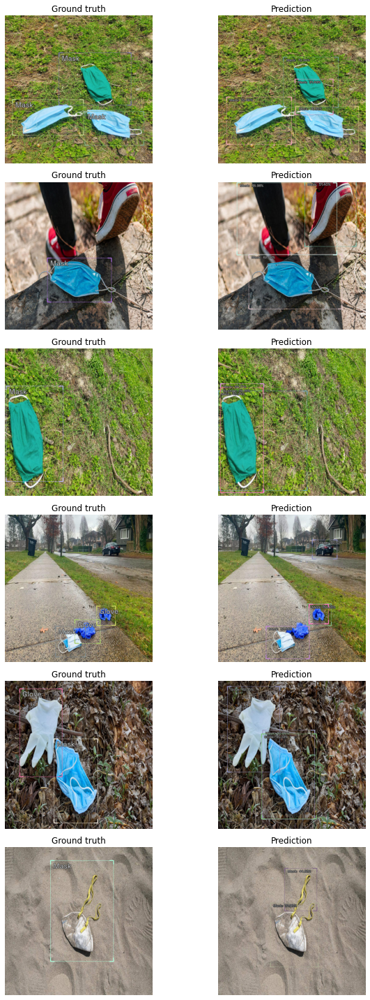

In [32]:
show_preds(preds=preds[:6], denormalize_fn=denormalize_imagenet, ncols=3, figsize=(10,20),)

In [33]:
import shortuuid

idx = shortuuid.uuid()[:5]
path = f"drive/MyDrive/effecientdnet-b0-ver2.0.0-{idx}.pth"
torch.save(model.state_dict(), path)

In [34]:
assert model.load_state_dict(torch.load(path, map_location="cpu"), strict=True)